In [1]:
import pandas  as pd
import numpy as np
import  matplotlib.pyplot as plt
import seaborn as sns

In [25]:
tn_df = pd.read_csv('data/train.csv')

ts_df = pd.read_csv('data/test.csv')
ts_df = ts_df.merge(pd.read_csv('data/sample_submission.csv'), how='left', on='Id')

In [36]:
def order_df(df):
    # Identify categorical columns automatically (typically object dtype for strings)
    categorical_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()

    # Convert them to numerical codes
    for col in categorical_cols:
        df[col] = df[col].astype('category').cat.codes
        
    df = df.drop(columns = ['Id'])
    
    return df


train_df = order_df(tn_df.copy())
test_df = order_df(ts_df.copy())

# get list of all the columns contains nans

train_nans = train_df.isna().sum()
train_nans = train_nans[train_nans > 0].keys()

test_nans = test_df.isna().sum()
test_nans = test_nans[test_nans > 0].keys()

print(test_nans)


nans = set(train_nans.values) | set(test_nans.values)
print(nans)

train_df = train_df.drop(nans, axis=1)
test_df = test_df.drop(nans, axis=1)

train_df

Index(['LotFrontage', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'BsmtFullBath', 'BsmtHalfBath', 'GarageYrBlt',
       'GarageCars', 'GarageArea'],
      dtype='object')
{'BsmtFullBath', 'GarageYrBlt', 'BsmtFinSF1', 'TotalBsmtSF', 'MasVnrArea', 'BsmtFinSF2', 'BsmtHalfBath', 'GarageArea', 'BsmtUnfSF', 'LotFrontage', 'GarageCars'}


,MSSubClass,MSZoning,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,3,8450,1,-1,3,3,0,4,0,...,0,-1,-1,-1,0,2,2008,8,4,208500
1,20,3,9600,1,-1,3,3,0,2,0,...,0,-1,-1,-1,0,5,2007,8,4,181500
2,60,3,11250,1,-1,0,3,0,4,0,...,0,-1,-1,-1,0,9,2008,8,4,223500
3,70,3,9550,1,-1,0,3,0,0,0,...,0,-1,-1,-1,0,2,2006,8,0,140000
4,60,3,14260,1,-1,0,3,0,2,0,...,0,-1,-1,-1,0,12,2008,8,4,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,60,3,7917,1,-1,3,3,0,4,0,...,0,-1,-1,-1,0,8,2007,8,4,175000
1456,20,3,13175,1,-1,3,3,0,4,0,...,0,-1,2,-1,0,2,2010,8,4,210000
1457,70,3,9042,1,-1,3,3,0,4,0,...,0,-1,0,2,2500,5,2010,8,4,266500
1458,20,3,9717,1,-1,3,3,0,4,0,...,0,-1,-1,-1,0,4,2010,8,4,142125


In [4]:
sns.pairplot(train_df)
plt.show()

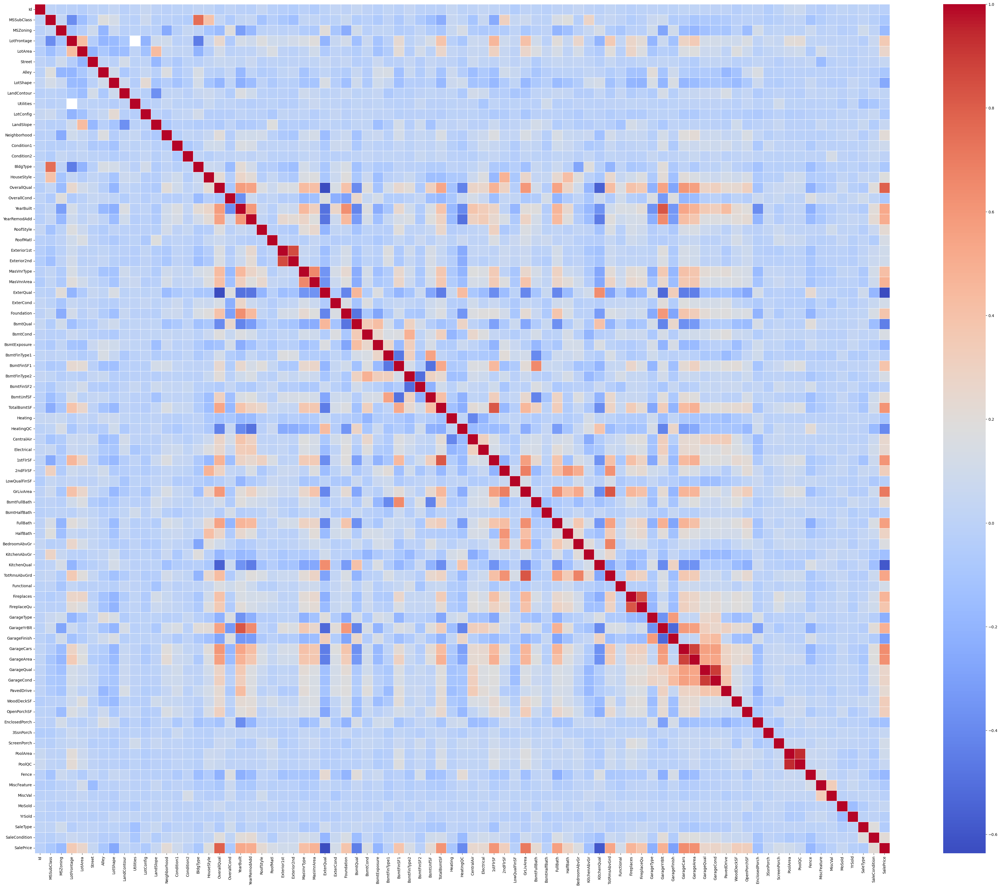

In [7]:

# plot reggression heatmap by pearson's R

corr = train_df.corr()
# make bigger heatmap figure
plt.figure(figsize=(50,40))
sns.heatmap(corr, linewidths=0.5, cmap='coolwarm')
plt.show()


Series([], dtype: int64)


<Axes: >

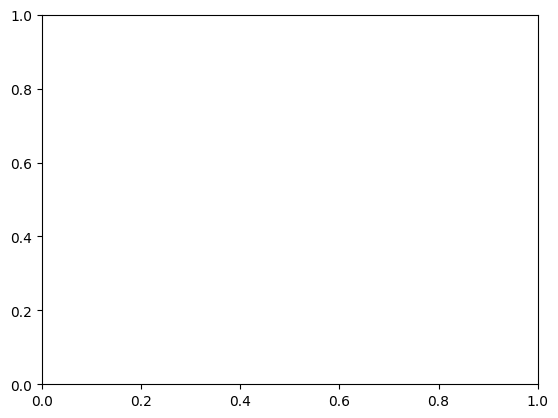

In [32]:
# plot nans amount bar chart for only the columns with nans
nans = test_df.isna().sum()
nans = nans[nans > 0]
nans = nans.sort_values(ascending=False)
print(nans)
sns.barplot(x=nans.index, y=nans.values)

In [40]:
#train_df[['LotFrontage', 'Stret']]# = train_df['LotFrontage'].fillna(train_df['LotFrontage'].mean())
train_df.columns

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       ...
       'SaleType_ConLw', 'SaleType_New', 'SaleType_Oth', 'SaleType_WD',
       'SaleCondition_Abnorml', 'SaleCondition_AdjLand',
       'SaleCondition_Alloca', 'SaleCondition_Family', 'SaleCondition_Normal',
       'SaleCondition_Partial'],
      dtype='object', length=289)

In [37]:
# train a linear regression model
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# split the data into training and test sets
X_train = train_df.drop(columns = ['SalePrice'])
y_train = train_df['SalePrice']
X_test = test_df.drop(columns = ['SalePrice'])
y_test = test_df['SalePrice']

# create a linear regression model
model = LinearRegression()

# fit the model to the training data
model.fit(X_train, y_train)

# make predictions on the test data
y_pred = model.predict(X_test)

# calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error:', mse)

# calculate the R^2 score
r2 = r2_score(y_test, y_pred)
print('R^2 Score:', r2)

# accuracy score
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

Mean Squared Error: 5011385899.462162
R^2 Score: -17.379121781148626


ValueError: continuous is not supported